# Final Project
This Notebook Describes results in "Economic/Development Indicators" Sections

In [2]:
import pandas as pd
import numpy as np

In [3]:
economic_data = pd.read_csv("world_bank_data.csv", header = 0)
economic_data.drop(economic_data.tail(5).index,inplace=True) # drop last n rows

In [4]:
from collections import defaultdict
economic_data_dict = defaultdict(list) #we will use country as key, year as other key then list all the data 

#extract years
years = []
for data in economic_data:
    data = data[0:4]
    years.append(data)
years = years[4:]

#extract series
series_info = []
prev_country = ""
for index, row in economic_data.iterrows():
    country_name = row[0]
    if country_name != prev_country and index != 0:
        break
    series_name = row[2]
    series_code = row[3]
    series_info.append((series_name, series_code))
    prev_country = country_name

#populate dict
for index, row in economic_data.iterrows():
    country_name = row[0]

    for i, year in enumerate(years):
        year_data_point = row[i+4]
        dict_key = (country_name,year)
        economic_data_dict[dict_key].append(year_data_point)


In [5]:
economic_data

,Country Name,Country Code,Series Name,Series Code,1960 [YR1960],1961 [YR1961],1962 [YR1962],1963 [YR1963],1964 [YR1964],1965 [YR1965],...,2011 [YR2011],2012 [YR2012],2013 [YR2013],2014 [YR2014],2015 [YR2015],2016 [YR2016],2017 [YR2017],2018 [YR2018],2019 [YR2019],2020 [YR2020]
0,Argentina,ARG,"Adolescent fertility rate (births per 1,000 wo...",SP.ADO.TFRT,61.388,61.248,61.108,60.9702,60.8324,60.6946,...,63.4412,63.567,63.41,63.253,63.096,62.939,62.782,62.5654,..,..
1,Argentina,ARG,"Agriculture, forestry, and fishing, value adde...",NV.AGR.TOTL.ZS,..,..,..,..,..,12.9041629886915,...,6.99873377022519,5.7817442068501,6.05291843670451,6.71270351428559,5.1566859021408,6.26456582010254,5.47838222945344,6.09712894763666,7.20078286820996,..
2,Argentina,ARG,"Annual freshwater withdrawals, total (% of int...",ER.H2O.FWTL.ZS,..,..,..,..,..,..,...,..,12.9075342465753,..,12.9075342465753,..,..,..,..,..,..
3,Argentina,ARG,Births attended by skilled health staff (% of ...,SH.STA.BRTC.ZS,..,..,..,..,..,..,...,97.14,98.2,97.04,99.6,99.6,..,..,..,..,..
4,Argentina,ARG,CO2 emissions (metric tons per capita),EN.ATM.CO2E.PC,2.38334297035428,2.45855142553302,2.53844603606137,2.33068505283097,2.55344179743567,2.65646573840291,...,4.64410645374173,4.62525961600278,4.58977417091963,4.5882296019405,4.6640107478523,4.61908548237078,..,..,..,..
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14515,Zimbabwe,ZWE,Tax revenue (% of GDP),GC.TAX.TOTL.GD.ZS,..,..,..,..,..,..,...,17.9282541990398,17.8354892203875,..,..,17.6733631953313,15.4583408165803,15.8743745304837,20.6586880097639,..,..
14516,Zimbabwe,ZWE,Terrestrial and marine protected areas (% of t...,ER.PTD.TOTL.ZS,..,..,..,..,..,..,...,..,..,..,..,..,27.2145424089062,27.2145851759137,27.2145851759137,..,..
14517,Zimbabwe,ZWE,Time required to start a business (days),IC.REG.DURS,..,..,..,..,..,..,...,87,87,91,91,91,91,61,32,27,..
14518,Zimbabwe,ZWE,"Total debt service (% of exports of goods, ser...",DT.TDS.DECT.EX.ZS,..,..,..,..,..,..,...,22.6651772733123,15.9667169191945,13.3393857445445,12.0732142109519,15.8749983548543,28.926041192327,14.4667558295191,12.5378733478502,..,..


In [6]:
series_info

[('Adolescent fertility rate (births per 1,000 women ages 15-19)',
  'SP.ADO.TFRT'),
 ('Agriculture, forestry, and fishing, value added (% of GDP)',
  'NV.AGR.TOTL.ZS'),
 ('Annual freshwater withdrawals, total (% of internal resources)',
  'ER.H2O.FWTL.ZS'),
 ('Births attended by skilled health staff (% of total)', 'SH.STA.BRTC.ZS'),
 ('CO2 emissions (metric tons per capita)', 'EN.ATM.CO2E.PC'),
 ('Contraceptive prevalence, any methods (% of women ages 15-49)',
  'SP.DYN.CONU.ZS'),
 ('Domestic credit provided by financial sector (% of GDP)',
  'FS.AST.DOMS.GD.ZS'),
 ('Electric power consumption (kWh per capita)', 'EG.USE.ELEC.KH.PC'),
 ('Energy use (kg of oil equivalent per capita)', 'EG.USE.PCAP.KG.OE'),
 ('Exports of goods and services (% of GDP)', 'NE.EXP.GNFS.ZS'),
 ('External debt stocks, total (DOD, current US$)', 'DT.DOD.DECT.CD'),
 ('Fertility rate, total (births per woman)', 'SP.DYN.TFRT.IN'),
 ('Foreign direct investment, net inflows (BoP, current US$)',
  'BX.KLT.DINV.CD.WD'

In [7]:
economic_data_dict.keys()

dict_keys([('Argentina', '1960'), ('Argentina', '1961'), ('Argentina', '1962'), ('Argentina', '1963'), ('Argentina', '1964'), ('Argentina', '1965'), ('Argentina', '1966'), ('Argentina', '1967'), ('Argentina', '1968'), ('Argentina', '1969'), ('Argentina', '1970'), ('Argentina', '1971'), ('Argentina', '1972'), ('Argentina', '1973'), ('Argentina', '1974'), ('Argentina', '1975'), ('Argentina', '1976'), ('Argentina', '1977'), ('Argentina', '1978'), ('Argentina', '1979'), ('Argentina', '1980'), ('Argentina', '1981'), ('Argentina', '1982'), ('Argentina', '1983'), ('Argentina', '1984'), ('Argentina', '1985'), ('Argentina', '1986'), ('Argentina', '1987'), ('Argentina', '1988'), ('Argentina', '1989'), ('Argentina', '1990'), ('Argentina', '1991'), ('Argentina', '1992'), ('Argentina', '1993'), ('Argentina', '1994'), ('Argentina', '1995'), ('Argentina', '1996'), ('Argentina', '1997'), ('Argentina', '1998'), ('Argentina', '1999'), ('Argentina', '2000'), ('Argentina', '2001'), ('Argentina', '2002'), 

In [43]:
country_year_df = pd.DataFrame.from_dict(economic_data_dict, orient = 'index')
country_year_df = country_year_df.replace('..', np.nan)
country_year_df = country_year_df.astype(float)
country_year_df = country_year_df.fillna(country_year_df.mean())
country_year_df = country_year_df / country_year_df.max(axis=0)

In [9]:
country_year_df

,0,1,2,3,4,5,6,7,8,9,...,45,46,47,48,49,50,51,52,53,54
"(Argentina, 1960)",0.264053,0.183340,0.01662,0.87473,0.006605,0.498776,0.060002,0.053282,0.053911,0.017552,...,0.437757,0.635018,0.382595,0.661872,0.039679,0.110923,0.128885,0.048034,0.105033,0.059967
"(Argentina, 1961)",0.263451,0.183340,0.01662,0.87473,0.006813,0.498776,0.051953,0.053282,0.053911,0.013838,...,0.437757,0.635018,0.382595,0.661872,0.021056,0.110923,0.128885,0.048034,0.105033,0.049955
"(Argentina, 1962)",0.262848,0.183340,0.01662,0.87473,0.007035,0.498776,0.047804,0.053282,0.053911,0.010830,...,0.437757,0.635018,0.382595,0.661872,0.021056,0.110923,0.128885,0.048034,0.105033,0.047787
"(Argentina, 1963)",0.262256,0.183340,0.01662,0.87473,0.006459,0.498776,0.049700,0.053282,0.053911,0.018213,...,0.437757,0.635018,0.382595,0.661872,0.021056,0.110923,0.128885,0.048034,0.105033,0.046951
"(Argentina, 1964)",0.261663,0.183340,0.01662,0.87473,0.007076,0.498776,0.048292,0.053282,0.053911,0.012843,...,0.437757,0.635018,0.382595,0.661872,0.021056,0.110923,0.128885,0.048034,0.105033,0.046125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"(Zimbabwe, 2016)",0.390034,0.088062,0.01662,0.87473,0.002169,0.498776,0.217521,0.053282,0.053911,0.046035,...,0.437757,0.635018,0.382595,0.561797,0.002959,0.103550,0.272909,0.130560,0.184409,0.026046
"(Zimbabwe, 2017)",0.370499,0.093284,0.01662,0.87473,0.013142,0.498776,0.217521,0.053282,0.053911,0.045376,...,0.437757,0.635018,0.382595,0.606741,0.002959,0.106337,0.272910,0.087518,0.092228,0.026099
"(Zimbabwe, 2018)",0.358083,0.092879,0.01662,0.87473,0.013142,0.498776,0.217521,0.053282,0.053911,0.043859,...,0.437757,0.635018,0.382595,0.606741,0.002959,0.138386,0.272910,0.045911,0.079931,0.027054
"(Zimbabwe, 2019)",0.329532,0.183340,0.01662,0.87473,0.013142,0.498776,0.217521,0.053282,0.053911,0.077535,...,0.437757,0.635018,0.382595,0.573033,0.039679,0.110923,0.128885,0.038737,0.105033,0.029075


In [10]:
country_labels = [] 
year_labels = [] 
for country, year in country_year_df.index: 
    country_labels.append(country)
    year_labels.append(int(year))

current_country = country_labels[0]
country_index = 0 
country_labels_int = []

for country in country_labels: 
    if country != current_country: 
        current_country = country 
        country_index += 1
    country_labels_int.append(country_index)

In [11]:
country_year_df.index

Index([('Argentina', '1960'), ('Argentina', '1961'), ('Argentina', '1962'),
       ('Argentina', '1963'), ('Argentina', '1964'), ('Argentina', '1965'),
       ('Argentina', '1966'), ('Argentina', '1967'), ('Argentina', '1968'),
       ('Argentina', '1969'),
       ...
        ('Zimbabwe', '2011'),  ('Zimbabwe', '2012'),  ('Zimbabwe', '2013'),
        ('Zimbabwe', '2014'),  ('Zimbabwe', '2015'),  ('Zimbabwe', '2016'),
        ('Zimbabwe', '2017'),  ('Zimbabwe', '2018'),  ('Zimbabwe', '2019'),
        ('Zimbabwe', '2020')],
      dtype='object', length=16104)

In [12]:
country_year_np = country_year_df.values

# K-Means Labeling

In [13]:
from sklearn.cluster import KMeans

In [14]:
kmeans = KMeans(n_clusters = 10, n_init=5, max_iter = 300).fit(country_year_np)

In [15]:
kmeans_labels = kmeans.labels_

In [16]:
len(kmeans_labels)

16104

# Coloring Embeddings

In [92]:
from sklearn.manifold import TSNE
import phate

def get_phate_embeddings(karr, coords):
    
    embeddings = []
    for i, knn in enumerate(karr):
        phate_operator = phate.PHATE(k=knn, verbose=False) #nearest operator 
        embedding = phate_operator.fit_transform(coords)
        embeddings.append(embedding)
       
    return embeddings

def get_tsne_embeddings(p, coords):
    embeddings = []
    for i, perplex in enumerate(p):
        embedding = TSNE(n_components=2, perplexity = perplex).fit_transform(coords)
        embeddings.append(embedding)
       
    return embeddings


def color_embeddings(embeddings, colorings, titles, graph_titles):
    import matplotlib.pyplot as plt 
    plt.style.use('ggplot')
    figsize = (20,5*len(colorings))
    
    _, plots = plt.subplots(len(colorings), len(embeddings), figsize = figsize)
    
    for i,coloring in enumerate(colorings):
        for j,embedding in enumerate(embeddings):
            if len(colorings) == 1:
                plots[j].scatter(embedding[:,0],embedding[:,1], c=coloring)
                plots[j].set_title(titles[0] + "," + graph_titles[j])
                continue 
            plots[i][j].scatter(embedding[:,0],embedding[:,1], c=coloring)
            plots[i][j].set_title(titles[i] + "," + graph_titles[j])

    plt.show()

    

In [ ]:
"""
USAGE in pset 3
PHATE_EMBEDDINGS = get_phate_embeddings([1,5,20,40], retinal_data_sub.values)
TSNE_EMBEDDINGS = get_tsne_embeddings([2,10,40,100], retinal_data_sub.values)
color_embeddings(TSNE_EMBEDDINGS, [retinal_kmeans_clus, retinal_spectral_clus,retinal_louvain_clus], ["K-means", "SC", "Louvain"], ["p = 2", "p = 10", "p = 40", "p = 100"])

Generally
PHATE_EMBEDDINGS = get_phate_embeddings([1,5,20,40], <dataset>)
TSNE_EMBEDDINGS = get_tsne_embeddings([2,10,40,100], <dataset>)
color_embeddings(<EMBEDDING>, [<list of colorings>], [<Titles for all colorings>], [<labels for each graph>])

"""

C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 1981 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))


    Using SMACOF because SGD returned NaN


C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 6289 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 20824 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: Runti

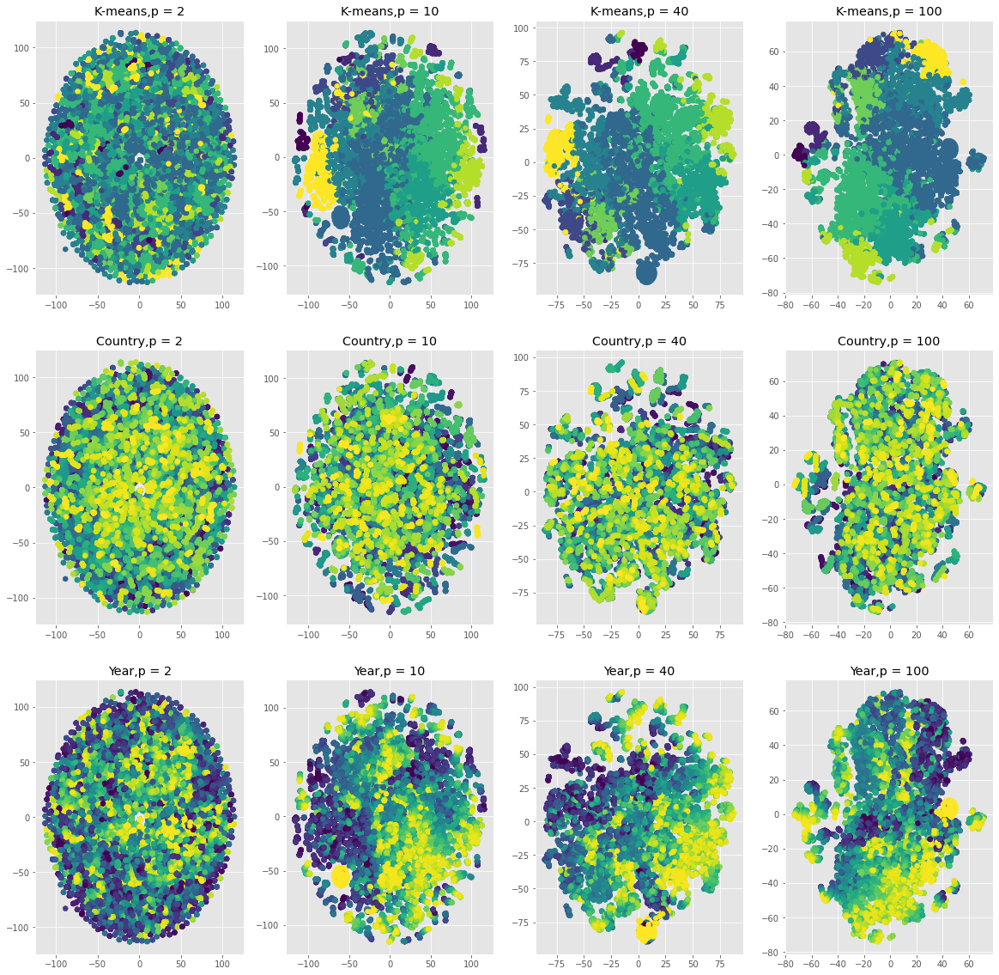

In [91]:
PHATE_EMBEDDINGS = get_phate_embeddings([1,5,20,40], country_year_np)
TSNE_EMBEDDINGS = get_tsne_embeddings([2,10,40,100], country_year_np)
color_embeddings(TSNE_EMBEDDINGS, [kmeans_labels, country_labels_int, year_labels], ["K-means", "Country", "Year"], ["p = 2", "p = 10", "p = 40", "p = 100"])

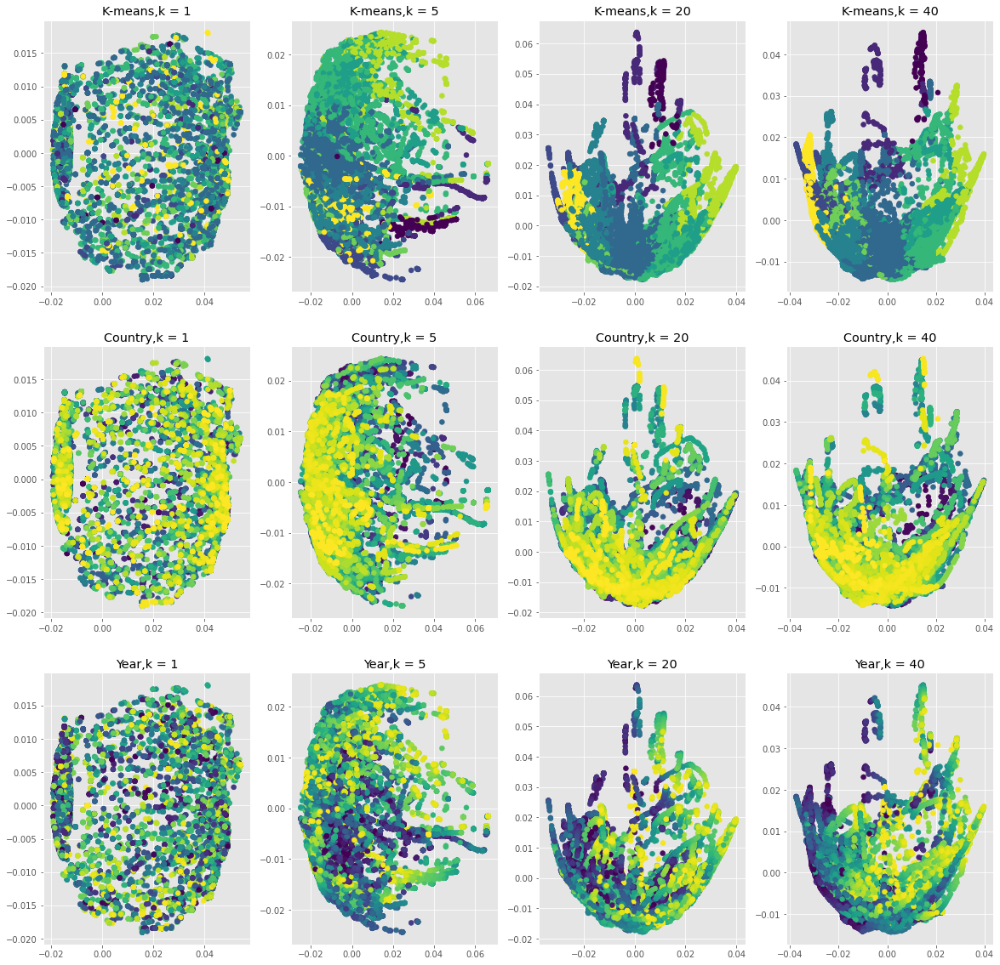

In [92]:
color_embeddings(PHATE_EMBEDDINGS, [kmeans_labels, country_labels_int, year_labels], ["K-means", "Country", "Year"], ["k = 1", "k = 5", "k = 20", "k = 40"])

In [94]:
country_labels_int[-1]

263

# rerunning

C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 1981 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))


    Using SMACOF because SGD returned NaN


C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 6289 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 20824 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: Runti

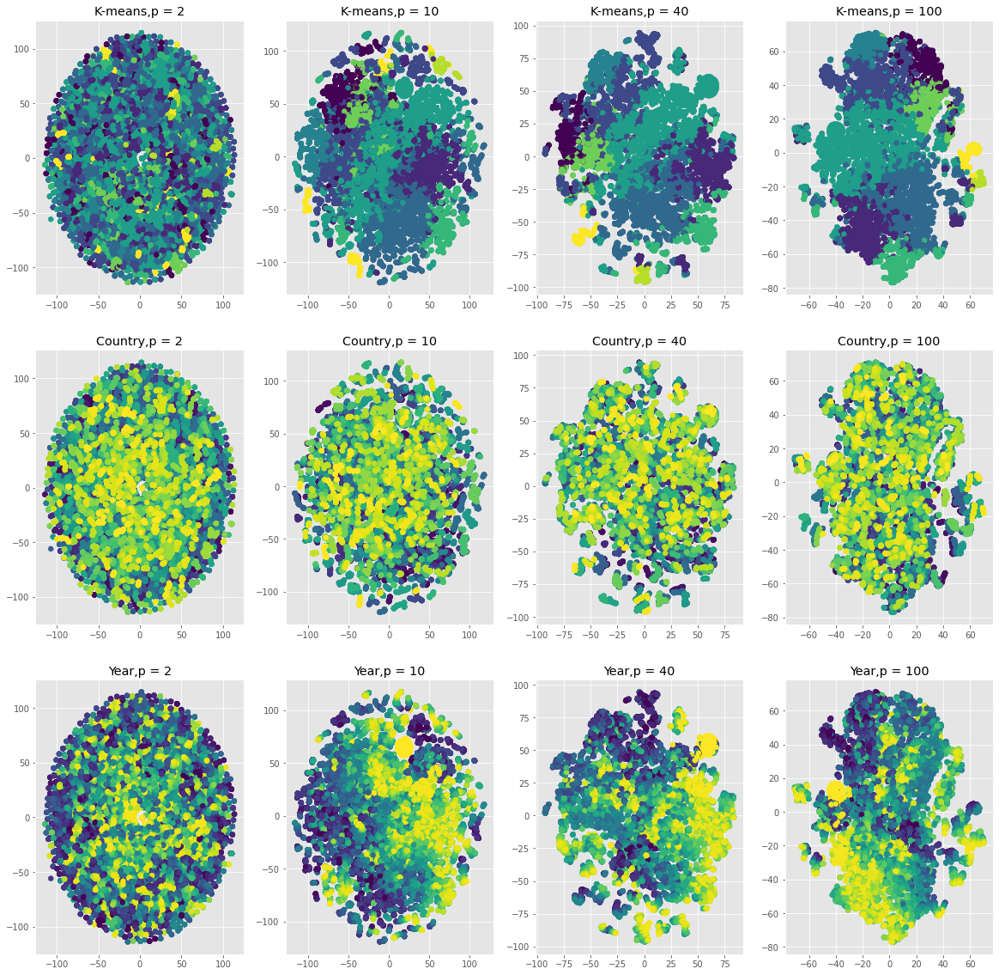

In [18]:
PHATE_EMBEDDINGS = get_phate_embeddings([1,5,20,40], country_year_np)
TSNE_EMBEDDINGS = get_tsne_embeddings([2,10,40,100], country_year_np)
color_embeddings(TSNE_EMBEDDINGS, [kmeans_labels, country_labels_int, year_labels], ["K-means", "Country", "Year"], ["p = 2", "p = 10", "p = 40", "p = 100"])


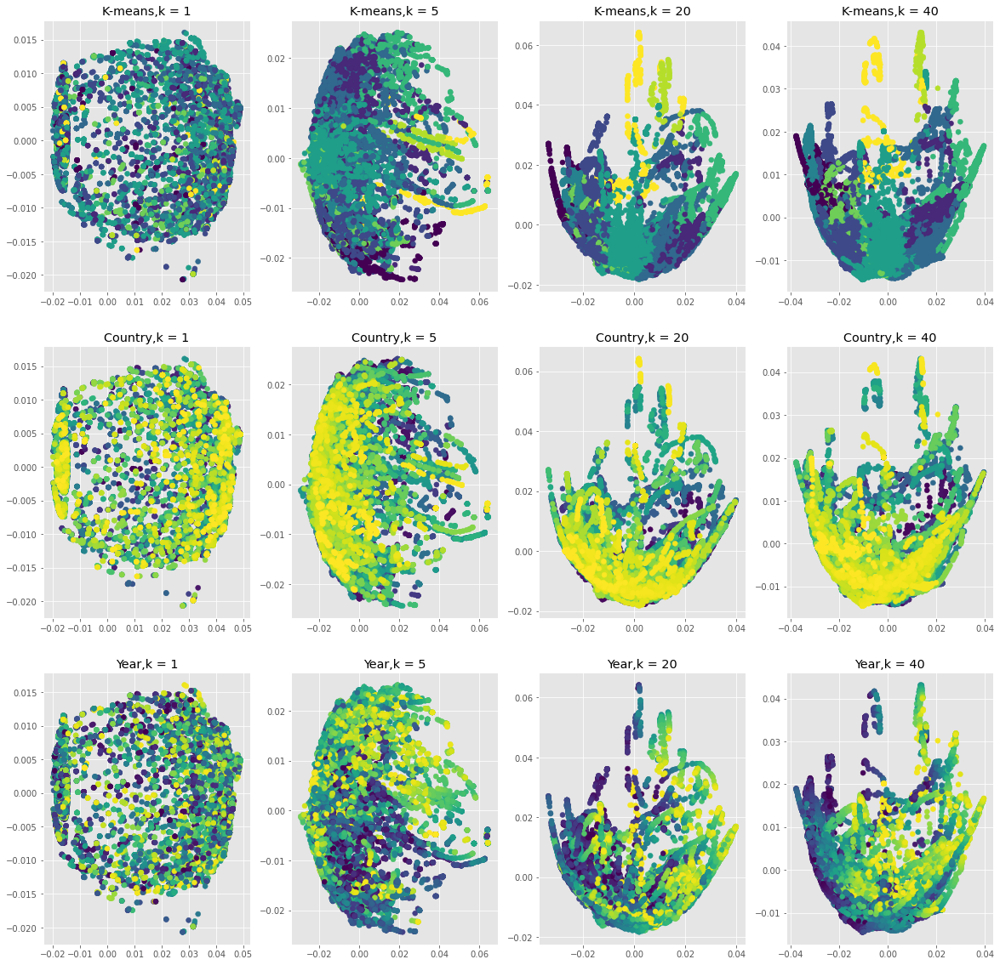

In [19]:
color_embeddings(PHATE_EMBEDDINGS, [kmeans_labels, country_labels_int, year_labels], ["K-means", "Country", "Year"], ["k = 1", "k = 5", "k = 20", "k = 40"])

# On PCA-reduced

In [20]:
import scprep

country_year_reduced, country_year_sv = scprep.reduce.pca(country_year_np, n_components = 10, return_singular_values=True)

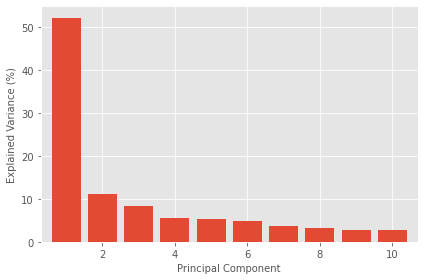

In [21]:
import matplotlib.pyplot as plt

plt.style.use('ggplot')
scprep.plot.scree_plot(country_year_sv, cumulative=False)
plt.show()

In [22]:
country_year_np.shape

(16104, 55)

In [116]:
# pca_eigval, pca_eigvec = np.linalg.eigh(country_year_np)
# order = np.argsort(pca_eigval)[::-1] # [::-1] reverses the order of a list
# pca_eigval, pca_eigvec = pca_eigval[order], pca_eigvec[:,order] 

In [82]:
kmeans_reduced = KMeans(n_clusters = 10, n_init=5, max_iter = 300).fit(country_year_reduced)
kmeans_labels_reduced = kmeans_reduced.labels_

In [88]:
vishnu_dict = defaultdict()

pickle_zip = list(zip(country_year_df.index, kmeans_labels_reduced))
for tuple_item in pickle_zip: 
    vishnu_dict[tuple_item[0]] = tuple_item[1]
    
vishnu_dict

defaultdict(None,
            {('Argentina', '1960'): 2,
             ('Argentina', '1961'): 2,
             ('Argentina', '1962'): 2,
             ('Argentina', '1963'): 2,
             ('Argentina', '1964'): 2,
             ('Argentina', '1965'): 2,
             ('Argentina', '1966'): 2,
             ('Argentina', '1967'): 2,
             ('Argentina', '1968'): 2,
             ('Argentina', '1969'): 2,
             ('Argentina', '1970'): 2,
             ('Argentina', '1971'): 2,
             ('Argentina', '1972'): 2,
             ('Argentina', '1973'): 2,
             ('Argentina', '1974'): 2,
             ('Argentina', '1975'): 2,
             ('Argentina', '1976'): 2,
             ('Argentina', '1977'): 2,
             ('Argentina', '1978'): 2,
             ('Argentina', '1979'): 2,
             ('Argentina', '1980'): 2,
             ('Argentina', '1981'): 2,
             ('Argentina', '1982'): 2,
             ('Argentina', '1983'): 2,
             ('Argentina', '1984'): 2,
       

In [89]:
import pickle

pickle.dump(vishnu_dict, open("coloring_economic.p", "wb"))

In [119]:
PHATE_EMBEDDINGS_reduced = get_phate_embeddings([1,5,20,40], country_year_reduced)

C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 1977 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))


    Using SMACOF because SGD returned NaN


C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 6273 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 20763 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: Runti

In [120]:
TSNE_EMBEDDINGS_reduced = get_tsne_embeddings([2,10,40,100], country_year_reduced)

In [91]:
pickle.dump(PHATE_EMBEDDINGS, open("PHATE_EMBEDDINGS.p", "wb"))
pickle.dump(TSNE_EMBEDDINGS, open("TSNE_EMBEDDINGS.p", "wb"))
pickle.dump(PHATE_EMBEDDINGS_reduced, open("PHATE_EMBEDDINGS_reduced.p", "wb"))
pickle.dump(TSNE_EMBEDDINGS_reduced, open("TSNE_EMBEDDINGS_reduced.p", "wb"))

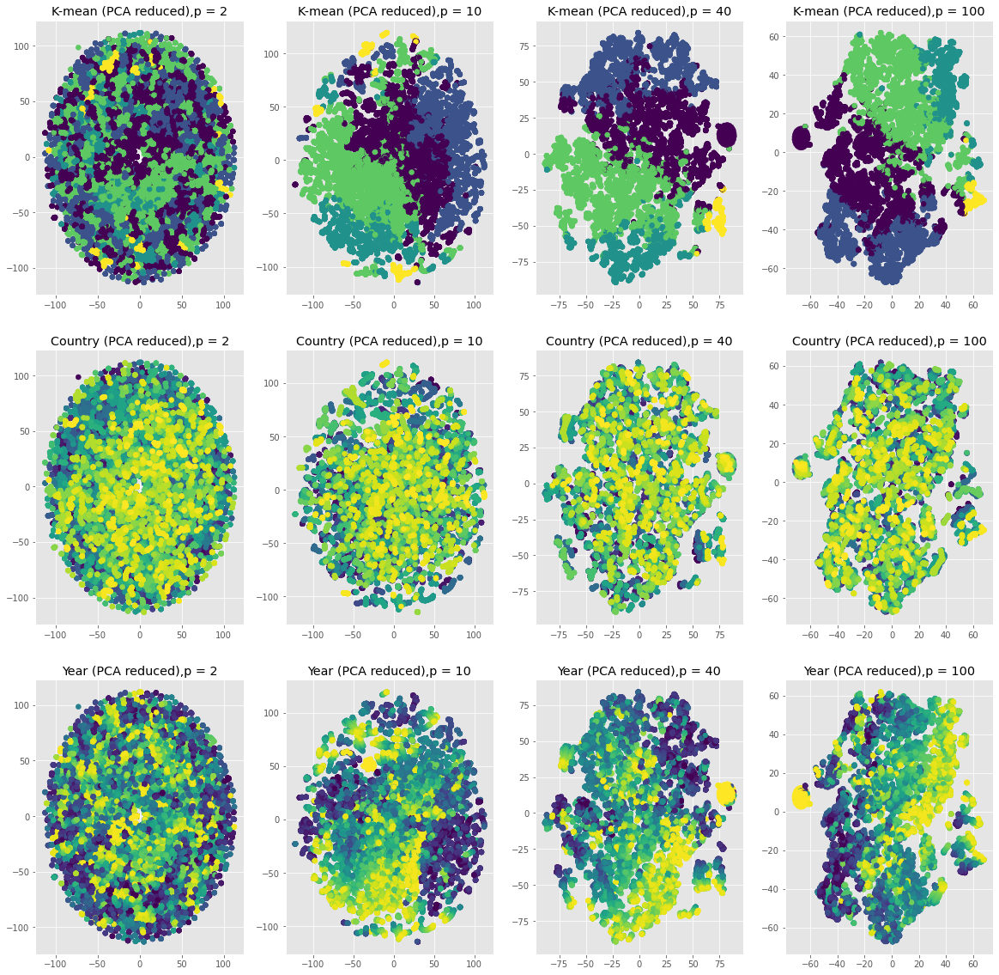

In [122]:
color_embeddings(TSNE_EMBEDDINGS_reduced, [kmeans_labels_reduced, country_labels_int, year_labels], ["K-mean (PCA reduced)", "Country (PCA reduced)", "Year (PCA reduced)"], ["p = 2", "p = 10", "p = 40", "p = 100"])

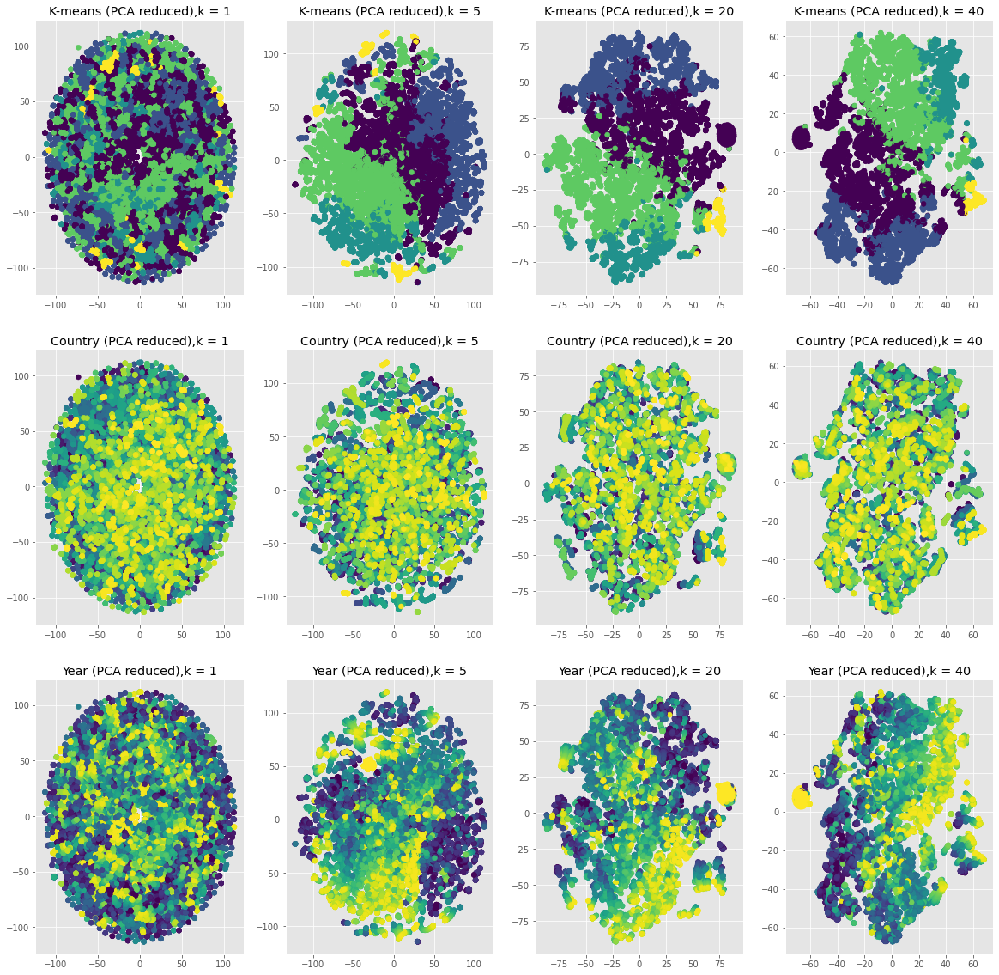

In [123]:
color_embeddings(TSNE_EMBEDDINGS_reduced, [kmeans_labels_reduced, country_labels_int, year_labels], ["K-means (PCA reduced)", "Country (PCA reduced)", "Year (PCA reduced)"], ["k = 1", "k = 5", "k = 20", "k = 40"])

# re-running PCA reduced

In [24]:
PHATE_EMBEDDINGS_reduced = get_phate_embeddings([1,5,20,40], country_year_reduced)

C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 1977 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))


    Using SMACOF because SGD returned NaN


C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 6273 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: RuntimeWarning: Detected zero distance between 20763 pairs of samples. Consider removing duplicates to avoid errors in downstream processing.
  warnings.warn(
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:451: RuntimeWarning: overflow encountered in power
  K.data = np.exp(-1 * np.power(K.data, self.decay))
C:\Users\Guo\AppData\Local\Programs\Python\Python38\lib\site-packages\graphtools\graphs.py:287: Runti

In [25]:
TSNE_EMBEDDINGS_reduced = get_tsne_embeddings([2,10,40,100], country_year_reduced)

# Looking at just Country, or just Year 

In [44]:
country_year_df_nan = pd.DataFrame.from_dict(economic_data_dict, orient = 'index')
country_year_df_nan = country_year_df_nan.replace('..', np.nan)
country_year_df_nan = country_year_df_nan.astype(float)
# country_year_df = country_year_df.fillna(country_year_df.mean())
country_year_df_nan = country_year_df_nan / country_year_df_nan.max(axis=0)

In [45]:
country_year_df_nan

,0,1,2,3,4,5,6,7,8,9,...,45,46,47,48,49,50,51,52,53,54
"(Argentina, 1960)",0.264053,NaN,NaN,NaN,0.006605,NaN,0.060002,NaN,NaN,0.017552,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
"(Argentina, 1961)",0.263451,NaN,NaN,NaN,0.006813,NaN,0.051953,NaN,NaN,0.013838,...,NaN,NaN,NaN,NaN,0.021056,NaN,NaN,NaN,NaN,0.049955
"(Argentina, 1962)",0.262848,NaN,NaN,NaN,0.007035,NaN,0.047804,NaN,NaN,0.010830,...,NaN,NaN,NaN,NaN,0.021056,NaN,NaN,NaN,NaN,0.047787
"(Argentina, 1963)",0.262256,NaN,NaN,NaN,0.006459,NaN,0.049700,NaN,NaN,0.018213,...,NaN,NaN,NaN,NaN,0.021056,NaN,NaN,NaN,NaN,0.046951
"(Argentina, 1964)",0.261663,NaN,NaN,NaN,0.007076,NaN,0.048292,NaN,NaN,0.012843,...,NaN,NaN,NaN,NaN,0.021056,NaN,NaN,NaN,NaN,0.046125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"(Zimbabwe, 2016)",0.390034,0.088062,NaN,NaN,0.002169,NaN,NaN,NaN,NaN,0.046035,...,NaN,NaN,NaN,0.561797,0.002959,0.103550,0.272909,0.130560,0.184409,0.026046
"(Zimbabwe, 2017)",0.370499,0.093284,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.045376,...,NaN,NaN,NaN,0.606741,0.002959,0.106337,0.272910,0.087518,0.092228,0.026099
"(Zimbabwe, 2018)",0.358083,0.092879,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.043859,...,NaN,NaN,NaN,0.606741,0.002959,0.138386,0.272910,0.045911,0.079931,0.027054
"(Zimbabwe, 2019)",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.573033,NaN,NaN,NaN,0.038737,NaN,0.029075


In [29]:
country_year_summary = country_year_df_nan.info()b

<class 'pandas.core.frame.DataFrame'>
Index: 16104 entries, ('Argentina', '1960') to ('Zimbabwe', '2020')
Data columns (total 55 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       14160 non-null  float64
 1   1       9694 non-null   float64
 2   2       677 non-null    float64
 3   3       2616 non-null   float64
 4   4       12978 non-null  float64
 5   5       1468 non-null   float64
 6   6       1262 non-null   float64
 7   7       7691 non-null   float64
 8   8       7887 non-null   float64
 9   9       10666 non-null  float64
 10  10      5775 non-null   float64
 11  11      14262 non-null  float64
 12  12      10887 non-null  float64
 13  13      6893 non-null   float64
 14  14      12372 non-null  float64
 15  15      11892 non-null  float64
 16  16      10716 non-null  float64
 17  17      6768 non-null   float64
 18  18      10717 non-null  float64
 19  19      6771 non-null   float64
 20  20      9927 non-null   float64
 21  21   

In [34]:
series_info

[('Adolescent fertility rate (births per 1,000 women ages 15-19)',
  'SP.ADO.TFRT'),
 ('Agriculture, forestry, and fishing, value added (% of GDP)',
  'NV.AGR.TOTL.ZS'),
 ('Annual freshwater withdrawals, total (% of internal resources)',
  'ER.H2O.FWTL.ZS'),
 ('Births attended by skilled health staff (% of total)', 'SH.STA.BRTC.ZS'),
 ('CO2 emissions (metric tons per capita)', 'EN.ATM.CO2E.PC'),
 ('Contraceptive prevalence, any methods (% of women ages 15-49)',
  'SP.DYN.CONU.ZS'),
 ('Domestic credit provided by financial sector (% of GDP)',
  'FS.AST.DOMS.GD.ZS'),
 ('Electric power consumption (kWh per capita)', 'EG.USE.ELEC.KH.PC'),
 ('Energy use (kg of oil equivalent per capita)', 'EG.USE.PCAP.KG.OE'),
 ('Exports of goods and services (% of GDP)', 'NE.EXP.GNFS.ZS'),
 ('External debt stocks, total (DOD, current US$)', 'DT.DOD.DECT.CD'),
 ('Fertility rate, total (births per woman)', 'SP.DYN.TFRT.IN'),
 ('Foreign direct investment, net inflows (BoP, current US$)',
  'BX.KLT.DINV.CD.WD'

In [48]:
candidates = [0, 11, 36, 37, 38, 49, 54]
gdp_info = [14, 15]
candidate_series = []
for i in range(len(series_info)): 
    if i in candidates or i in gdp_info: 
        candidate_series.append(series_info[i][0])

candidate_series_indexes = candidates + gdp_info
candidate_series_indexes.sort()
candidate_series

['Adolescent fertility rate (births per 1,000 women ages 15-19)',
 'Fertility rate, total (births per woman)',
 'GDP (current US$)',
 'GDP growth (annual %)',
 'Population density (people per sq. km of land area)',
 'Population growth (annual %)',
 'Population, total',
 'Surface area (sq. km)',
 'Urban population growth (annual %)']

In [46]:
candidate_labels_df = pd.DataFrame(columns = candidate_series)

candidate_labels_dict = defaultdict(list)

for i, row in country_year_df_nan.iterrows(): 
    for j in candidate_series_indexes: 
        if np.isnan(float(row[j])): 
            candidate_labels_dict[j].append(0)
        else: 
            candidate_labels_dict[j].append(float(row[j]))

In [47]:
candidate_labels_dict

defaultdict(list,
            {0: [0.2640528071203241,
              0.2634506146234705,
              0.26284842212661697,
              0.262255692654714,
              0.261662963182811,
              0.26107023371090804,
              0.26047750423900506,
              0.25988477476710203,
              0.26675062950622797,
              0.2736164842453539,
              0.2804823389844798,
              0.28734819372360565,
              0.29421404846273164,
              0.30679212917201115,
              0.31937020988129067,
              0.3319482905905702,
              0.3445263712998497,
              0.3571044520091292,
              0.3495168265487746,
              0.3419292010884199,
              0.33434157562806527,
              0.32675395016771064,
              0.3191663247073559,
              0.31847724443595643,
              0.31778816416455685,
              0.3170990838931573,
              0.3164100036217577,
              0.3157209233503582,
              0.

In [50]:
candidate_series_indexes

[0, 11, 14, 15, 36, 37, 38, 49, 54]

In [54]:
test_zip = list(zip(candidate_labels_dict[0], country_year_df_nan.index))
test_zip

[(0.2640528071203241, ('Argentina', '1960')),
 (0.2634506146234705, ('Argentina', '1961')),
 (0.26284842212661697, ('Argentina', '1962')),
 (0.262255692654714, ('Argentina', '1963')),
 (0.261662963182811, ('Argentina', '1964')),
 (0.26107023371090804, ('Argentina', '1965')),
 (0.26047750423900506, ('Argentina', '1966')),
 (0.25988477476710203, ('Argentina', '1967')),
 (0.26675062950622797, ('Argentina', '1968')),
 (0.2736164842453539, ('Argentina', '1969')),
 (0.2804823389844798, ('Argentina', '1970')),
 (0.28734819372360565, ('Argentina', '1971')),
 (0.29421404846273164, ('Argentina', '1972')),
 (0.30679212917201115, ('Argentina', '1973')),
 (0.31937020988129067, ('Argentina', '1974')),
 (0.3319482905905702, ('Argentina', '1975')),
 (0.3445263712998497, ('Argentina', '1976')),
 (0.3571044520091292, ('Argentina', '1977')),
 (0.3495168265487746, ('Argentina', '1978')),
 (0.3419292010884199, ('Argentina', '1979')),
 (0.33434157562806527, ('Argentina', '1980')),
 (0.32675395016771064, ('A

In [72]:
from copy import deepcopy

def generate_rankings(raw_values_list, index_list): 
    temp_zip = list(zip(raw_values_list, index_list))
    # temp_zero_count = raw_values_list.count(0)
    
    sorted_list = deepcopy(temp_zip)
    sorted_list.sort(key = lambda x: x[0])

    output_list = []
    
    rank = 0 
    
    for item in sorted_list: # looks like value, key tuple 
        if item[0] == 0: 
            output_list.append((0, item[1]))
        else: 
            rank += 1 
            output_list.append((rank, item[1]))
        
    def lookup(key, tuple_list): 
        for item in tuple_list: 
            if item[1] == key: 
                return item[0]
    
    final_list = [] 
    
    for index in index_list: 
        final_list.append(lookup(index, output_list))
    
    return final_list

In [76]:
rankings_dict = defaultdict(list)

for key_value in candidate_labels_dict:
    rankings_dict[key_value] = generate_rankings(candidate_labels_dict[key_value], country_year_df_nan.index)

In [81]:
color_pickle_df = pd.DataFrame.from_dict(rankings_dict)
color_pickle_df.index = country_year_df_nan.index
color_pickle_df

,0,11,36,37,38,49,54,14,15
"(Argentina, 1960)",6619,6302,0,0,10618,0,0,0,0
"(Argentina, 1961)",6604,6281,1389,7249,10645,12152,6835,0,8102
"(Argentina, 1962)",6592,6258,1409,7148,10673,12153,6533,6749,1279
"(Argentina, 1963)",6579,6239,1425,7049,10697,12154,6416,6350,406
"(Argentina, 1964)",6567,6214,1442,6949,10727,12155,6305,6806,11122
...,...,...,...,...,...,...,...,...,...
"(Zimbabwe, 2016)",9048,7393,5975,6951,9920,8989,3810,6512,2163
"(Zimbabwe, 2017)",8677,7259,6034,6578,9945,8990,3820,6618,7185
"(Zimbabwe, 2018)",8444,7120,6093,6415,9972,8991,3928,6740,7379
"(Zimbabwe, 2019)",0,0,0,6449,10001,0,4148,6566,227


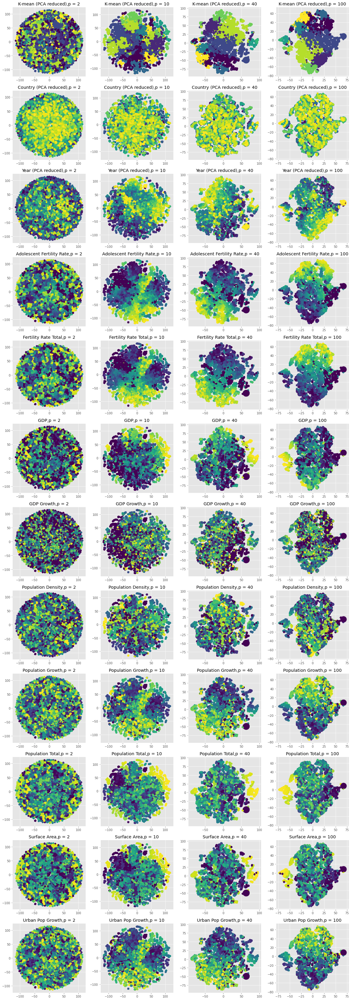

In [99]:
color_embeddings(TSNE_EMBEDDINGS_reduced, 
                 [kmeans_labels_reduced, country_labels_int, year_labels, 
                 rankings_dict[0],  
                 rankings_dict[11], 
                 rankings_dict[14], 
                 rankings_dict[15],
                 rankings_dict[36],
                 rankings_dict[37], 
                 rankings_dict[38], 
                 rankings_dict[49], 
                 rankings_dict[54]], 
                 ["K-mean (PCA reduced)", "Country (PCA reduced)", "Year (PCA reduced)", 
                 "Adolescent Fertility Rate", 
                 "Fertility Rate Total", 
                 "GDP", 
                 "GDP Growth", 
                 "Population Density", 
                 "Population Growth", 
                 "Population Total", 
                 "Surface Area", 
                 "Urban Pop Growth"], 
                 ["p = 2", "p = 10", "p = 40", "p = 100"])

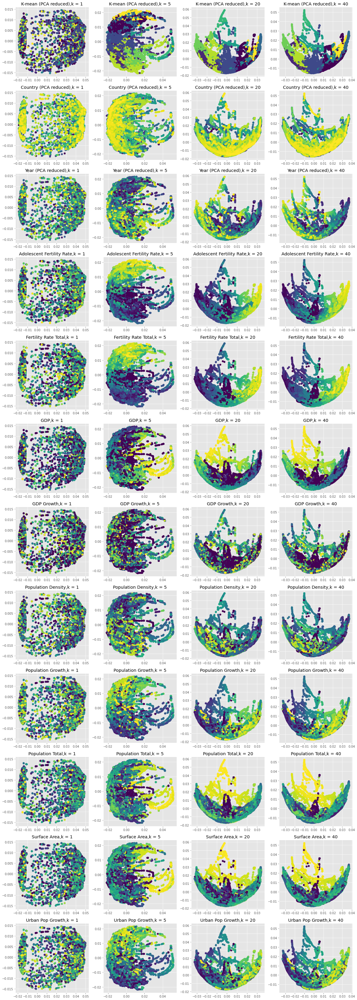

In [95]:
color_embeddings(PHATE_EMBEDDINGS_reduced, 
                 [kmeans_labels_reduced, country_labels_int, year_labels, 
                 rankings_dict[0],  
                 rankings_dict[11], 
                 rankings_dict[14], 
                 rankings_dict[15],
                 rankings_dict[36],
                 rankings_dict[37], 
                 rankings_dict[38], 
                 rankings_dict[49], 
                 rankings_dict[54]], 
                 ["K-mean (PCA reduced)", "Country (PCA reduced)", "Year (PCA reduced)", 
                 "Adolescent Fertility Rate", 
                 "Fertility Rate Total", 
                 "GDP", 
                 "GDP Growth", 
                 "Population Density", 
                 "Population Growth", 
                 "Population Total", 
                 "Surface Area", 
                 "Urban Pop Growth"], 
                 ["k = 1", "k = 5", "k = 20", "k = 40"])

# Olympic Coloring

In [107]:
olympic_colors_dict = pickle.load(open( "coloring_olympic.p", "rb"))

In [108]:
olympic_colors_dict

{('China', '1992'): 7,
 ('China', '2012'): 7,
 ('Finland', '2000'): 3,
 ('Finland', '1996'): 0,
 ('Romania', '2016'): 7,
 ('Norway', '2000'): 3,
 ('Norway', '2004'): 0,
 ('Norway', '1968'): 3,
 ('Norway', '1972'): 7,
 ('Netherlands', '1996'): 3,
 ('Netherlands', '2000'): 0,
 ('Finland', '1992'): 3,
 ('France', '2012'): 7,
 ('Norway', '1996'): 7,
 ('Norway', '1992'): 3,
 ('Norway', '1960'): 7,
 ('Estonia', '2004'): 0,
 ('Estonia', '2008'): 0,
 ('Estonia', '1992'): 0,
 ('Estonia', '1996'): 0,
 ('Spain', '2016'): 3,
 ('France', '1976'): 7,
 ('Egypt, Arab Rep.', '2000'): 3,
 ('Bulgaria', '1988'): 7,
 ('Bulgaria', '1960'): 7,
 ('Italy', '2016'): 3,
 ('Spain', '2008'): 7,
 ('Azerbaijan', '2016'): 3,
 ('Sudan', '1972'): 5,
 ('Russian Federation', '2008'): 7,
 ('Russian Federation', '2012'): 7,
 ('Argentina', '2000'): 3,
 ('Cuba', '2000'): 7,
 ('Cuba', '1992'): 5,
 ('Belarus', '2004'): 7,
 ('Belarus', '2008'): 7,
 ('France', '2008'): 7,
 ('France', '2016'): 7,
 ('Argentina', '2012'): 3,
 ('Gre

In [109]:
olympic_indexes = []
olympic_colors = [] 
ALL_INDEXES = color_pickle_df.index

for i in range(len(ALL_INDEXES)): 
    if ALL_INDEXES[i] in olympic_colors_dict.keys(): 
        olympic_indexes.append(i)
        olympic_colors.append(olympic_colors_dict[ALL_INDEXES[i]])

olympic_indexes

[0,
 4,
 8,
 12,
 16,
 24,
 28,
 32,
 36,
 40,
 44,
 48,
 52,
 56,
 61,
 65,
 69,
 73,
 77,
 81,
 85,
 89,
 93,
 97,
 101,
 105,
 109,
 113,
 117,
 122,
 126,
 130,
 134,
 138,
 142,
 146,
 150,
 154,
 158,
 162,
 166,
 170,
 174,
 178,
 183,
 187,
 191,
 195,
 199,
 207,
 211,
 215,
 219,
 223,
 227,
 231,
 235,
 239,
 244,
 248,
 252,
 256,
 260,
 264,
 268,
 272,
 276,
 280,
 284,
 288,
 292,
 296,
 300,
 305,
 309,
 313,
 317,
 321,
 325,
 329,
 333,
 337,
 341,
 345,
 349,
 353,
 357,
 361,
 366,
 370,
 374,
 378,
 382,
 386,
 390,
 394,
 398,
 402,
 406,
 410,
 414,
 418,
 422,
 427,
 435,
 439,
 443,
 451,
 455,
 459,
 463,
 467,
 471,
 475,
 479,
 483,
 488,
 492,
 496,
 500,
 504,
 508,
 512,
 516,
 520,
 524,
 528,
 532,
 536,
 540,
 544,
 549,
 553,
 557,
 561,
 565,
 573,
 577,
 581,
 585,
 589,
 593,
 597,
 601,
 605,
 610,
 614,
 618,
 622,
 626,
 634,
 638,
 642,
 646,
 650,
 654,
 658,
 662,
 666,
 671,
 675,
 679,
 683,
 687,
 691,
 695,
 699,
 703,
 707,
 711,
 715,
 

In [110]:
olympic_colors

[7,
 7,
 3,
 3,
 3,
 3,
 5,
 5,
 3,
 3,
 3,
 3,
 3,
 3,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 3,
 3,
 0,
 3,
 5,
 0,
 3,
 3,
 3,
 7,
 3,
 7,
 7,
 3,
 3,
 7,
 3,
 3,
 7,
 2,
 3,
 3,
 0,
 4,
 7,
 7,
 7,
 7,
 7,
 7,
 3,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 2,
 2,
 2,
 5,
 2,
 5,
 5,
 0,
 5,
 5,
 5,
 5,
 3,
 5,
 5,
 5,
 2,
 5,
 5,
 3,
 3,
 5,
 5,
 5,
 5,
 0,
 2,
 4,
 7,
 7,
 7,
 7,
 7,
 3,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 3,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 3,
 0,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 3,
 7,
 7,
 3,
 5,
 7,
 7,
 3,
 5,
 5,
 3,
 5,
 5,
 5,
 3,
 3,
 5,
 3,
 3,
 3,
 3,
 3,
 3,
 3,
 0,
 0,
 0,
 0,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 6,
 6,
 2,
 2,
 6,
 2,
 2,
 2,
 2,
 2,
 2,
 5,
 3,
 3,
 7,
 7,
 3,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 7,
 3,
 7,
 7,
 7,
 7,
 7,
 0,
 7,
 3,
 7,
 3,
 3,
 3,
 3,
 3,
 3,
 0,
 0,
 5,
 3,
 5,
 3,


In [118]:
PHATE_EMBEDDINGS_olympic = []
TSNE_EMBEDDINGS_olympic = []

def filter_list(full_list, good_indexes = olympic_indexes): 
    return [full_list[i] for i in olympic_indexes]

for embedding in PHATE_EMBEDDINGS_reduced: 
    PHATE_EMBEDDINGS_olympic.append(filter_list(embedding))
    
for embedding in TSNE_EMBEDDINGS_reduced: 
    TSNE_EMBEDDINGS_olympic.append(filter_list(embedding))
    
PHATE_EMBEDDINGS_olympic = np.array(PHATE_EMBEDDINGS_olympic)
TSNE_EMBEDDINGS_olympic = np.array(TSNE_EMBEDDINGS_olympic)

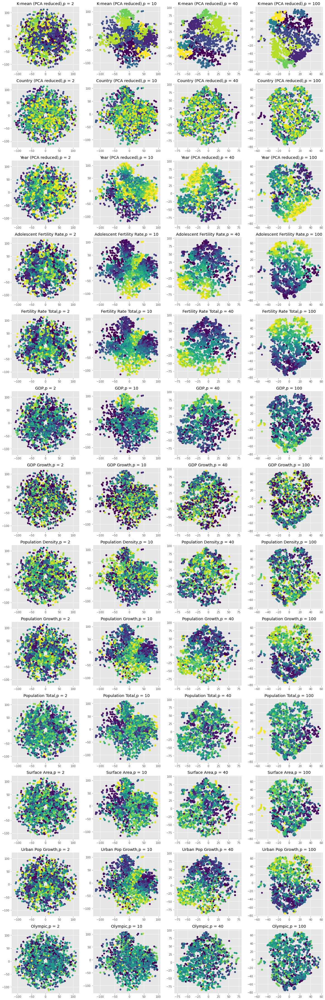

In [120]:
color_embeddings(TSNE_EMBEDDINGS_olympic, 
                 [filter_list(kmeans_labels_reduced), filter_list(country_labels_int), filter_list(year_labels), 
                 filter_list(rankings_dict[0]),  
                 filter_list(rankings_dict[11]), 
                 filter_list(rankings_dict[14]), 
                 filter_list(rankings_dict[15]),
                 filter_list(rankings_dict[36]),
                 filter_list(rankings_dict[37]), 
                 filter_list(rankings_dict[38]), 
                 filter_list(rankings_dict[49]), 
                 filter_list(rankings_dict[54]), 
                 olympic_colors], 
                 ["K-mean (PCA reduced)", "Country (PCA reduced)", "Year (PCA reduced)", 
                 "Adolescent Fertility Rate", 
                 "Fertility Rate Total", 
                 "GDP", 
                 "GDP Growth", 
                 "Population Density", 
                 "Population Growth", 
                 "Population Total", 
                 "Surface Area", 
                 "Urban Pop Growth", 
                 "Olympic"], 
                 ["p = 2", "p = 10", "p = 40", "p = 100"])

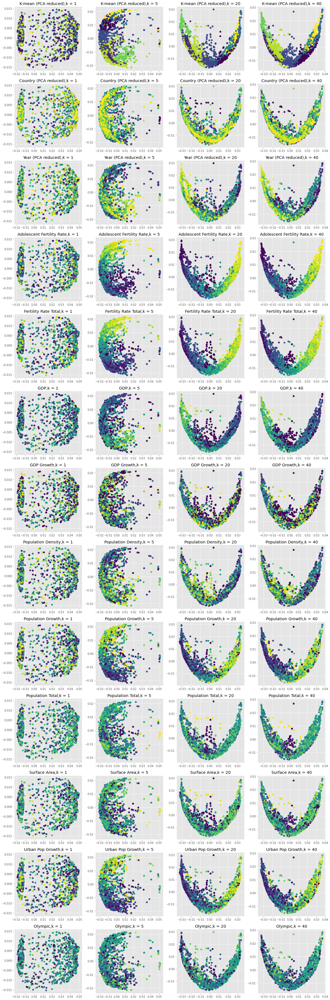

In [121]:
color_embeddings(PHATE_EMBEDDINGS_olympic, 
                 [filter_list(kmeans_labels_reduced), filter_list(country_labels_int), filter_list(year_labels), 
                 filter_list(rankings_dict[0]),  
                 filter_list(rankings_dict[11]), 
                 filter_list(rankings_dict[14]), 
                 filter_list(rankings_dict[15]),
                 filter_list(rankings_dict[36]),
                 filter_list(rankings_dict[37]), 
                 filter_list(rankings_dict[38]), 
                 filter_list(rankings_dict[49]), 
                 filter_list(rankings_dict[54]), 
                 olympic_colors], 
                 ["K-mean (PCA reduced)", "Country (PCA reduced)", "Year (PCA reduced)", 
                 "Adolescent Fertility Rate", 
                 "Fertility Rate Total", 
                 "GDP", 
                 "GDP Growth", 
                 "Population Density", 
                 "Population Growth", 
                 "Population Total", 
                 "Surface Area", 
                 "Urban Pop Growth", 
                 "Olympic"], 
                 ["k = 1", "k = 5", "k = 20", "k = 40"])

In [1]:
def get_country_df(country_name, country_year_df): 
    subset = country_year_df.loc[country_year_df.index[0] == country_name, :]
    return subset

In [ ]:
from datapackage import Package
package = Package('https://datahub.io/JohnSnowLabs/country-and-continent-codes-list/datapackage.json')
# print list of all resources:
# print(package.resource_names)
csv_continent_data = None
# print processed tabular data (if exists any)
for resource in package.resources:
    if resource.descriptor['datahub']['type'] == 'derived/csv':
        csv_continent_data = resource.read()
        
        
def convert_country_to_cont(country):
    
    if isinstance(country, float):
        return "XX"
    
    contenders = [] 
    for row in csv_continent_data:
        count_name = row[2]
        num_char = int(float(len(count_name)/1.5))
        if country[0:num_char] in count_name:
            contenders.append((count_name, row[1]))

    if len(contenders) == 0:
#         print(country)
#         print("ERROR")
        return "XX"
    
    min_len = 1000
    min_cont = "XX"
    for country_guess, cont in contenders:
        if abs(len(country_guess)-len(country)) < min_len:
            min_len = abs(len(country_guess)-len(country))
            min_cont = cont
            
    return min_cont
        

def color_by_continent(list_of_indexes):
    coloring = []
    dict_continent = {}
    counter = 0 
    for index in list_of_indexes:
        key = list_of_country_year[index]
        country = key[0]
        cont = convert_country_to_cont(country) 
        if cont not in dict_continent:
            dict_continent[cont] = counter
            counter += 1
        coloring.append(dict_continent[cont])
        
    return coloring, dict_continent
  
  
  
#########################


from prettytable import PrettyTable
def print_clusters(cluster_labels, list_of_indexes):
    assert len(cluster_labels) == len(list_of_indexes)
    cluster_dict = defaultdict(list)
    for i in range(0, len(list_of_indexes)):
        index = list_of_indexes[i]
        cluster_id = cluster_labels[i]
        cluster_dict[cluster_id].append(list_of_country_year[index])
        
    max_length_column = 0 
    for key in cluster_dict:
        max_length_column = max(max_length_column, len(cluster_dict[key]))
        
    counter = 0
    my_table = PrettyTable()
    for key in cluster_dict:
        
        if counter % 3 == 0:
            print(my_table)
            my_table = PrettyTable()
        
        lst_of_countries = cluster_dict[key]
        lst_of_countries = sorted(lst_of_countries, key = lambda x: int(x[1]))
        lst_of_countries = sorted(lst_of_countries, key = lambda x: str(x[0]))
        
        for i in range(0,len(lst_of_countries)):
            lst_of_countries[i] = str(lst_of_countries[i][0])+"({})".format(lst_of_countries[i][1])
        
        num_null_pads = max_length_column-len(lst_of_countries)
        for i in range(num_null_pads):
            lst_of_countries.append("")
            
        my_table.add_column("Cluster:"+str(key),lst_of_countries)
        
        counter +=1 